<a href="https://colab.research.google.com/github/kutaytire/CS-102-Assignments/blob/main/Contrastive_learning.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Contrastive Learning Tutorial in PyTorch with Point Clouds



## Installation / Setup

In [1]:
# We will use conda for easier installation of PyG
# If only using pip, it somehow takes forever to install on colab
!pip install -q condacolab
import condacolab
condacolab.install()

✨🍰✨ Everything looks OK!


In [2]:
pip install open3d

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 420.5/420.5 MB 3.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 138.3/138.3 kB 17.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 242.5/242.5 kB 27.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 77.1/77.1 kB 5.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.4/3.4 MB 92.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.3/12.3 MB 98.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 705.5/705.5 kB 51.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.4/10.4 MB 97.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.6/17.6 MB 84.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.8/10.8 MB 104.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.6/11.6 MB 107.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 93.7/93.7 kB 12.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━

In [3]:
# Install torch geometric for point-cloud layers
import torch
version = f"https://data.pyg.org/whl/torch-{torch.__version__}.html"
try:
    import torch_geometric
except:
    !echo $version
    !pip install torch-scatter torch-sparse torch-cluster torch-spline-conv torch-geometric -f $version
    import torch_geometric

https://data.pyg.org/whl/torch-2.0.1+cu118.html
Looking in links: https://data.pyg.org/whl/torch-2.0.1+cu118.html
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.2/10.2 MB 35.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.8/4.8 MB 27.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.3/3.3 MB 76.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 884.9/884.9 kB 62.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 661.6/661.6 kB 26.5 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for torch-geometric: filename=torch_geometric-2.3.1-py3-none-any.whl size=910459 sha256=c7fea0ef535ec7c8472186483ec685116d55d2fba79f4f2f8577ce3e8ac34aec
  Stored in directory: /root/.cache/pip/wheels/ac/dc/30/e2874821ff308ee67dcd7a66dbde912411e19e35a1addda028
Successfully built torch-geometric


In [4]:
from google.colab import files
files.upload()

Saving 9_armadillo.ply to 9_armadillo.ply


{'9_armadillo.ply': b'ply\nformat binary_big_endian 1.0\ncomment author: Paraform\nobj_info 3D colored patch boundaries \nelement vertex 172974\nproperty float x\nproperty float y\nproperty float z\nelement face 345944\nproperty uchar intensity\nproperty list uchar int vertex_indices\nend_header\n@\xbc\xa0aA<\x9dJA\xdaD\x13\xc2UL\xeaB\x865o\xc2e\xcc\xef@p\x08\x02A\x84\x0b\x10A\xeb\xa1\xd5\xc2 L\x01\xc2\x04\xf34A+\xdf\xda\xc2S@\xccB\x86#\x88\xc2fJ7\xc2Q\xb3\xc2B\x85\xab`\xc2e\x85\x84\xc2Q\x87\x88B\x86f\xa4\xc2f&\x17\xc2\x0f"IA\x0c\x967A\x8c\xd3qA\x9e%\xe0\xc2=\x8d\xd4@\xe9\xf8\xbaA\xfe\x06W\xc2=\x8a/@\xe9z\x13\xc2S\xdc\xb9B\x87\x07\x9a\xc2fyP\xc2Q\xf3\xe6B\x87#\xd9\xc2f\xdb\xaa\xc2@\x8b\xc8\xc2<\x91\xb5@\xe9\xf8\xba\xc2P\x11GB\x86\xf7c\xc2f\x00\x1e@\xcaYDA<\x9dJA\xda+\xa1\xc0\xd15"AX\x0f\x10A\xe6\x05(\xc1\xb2\xa3b\xc2\x04\xf34A+\xdf\xda\xc2S^\x90B\x87\xf2\xe0\xc2fz\x02\xc2Q\x9d}B\x87\xe5\xd6\xc2f\xa6\xfd\xc0\x8c\xb4\xb7B1\x83\xaeB\x0bZ\xd0\xc2O\xfc\xb9B\x87\xe0\x0b\xc2e\xba\xf6\xc2U \xf

In [5]:
pip install trimesh

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 682.5/682.5 kB 22.2 MB/s eta 0:00:00


In [6]:
import numpy as np
from scipy.spatial import KDTree
import open3d as o3d
import trimesh


def create_patches(sampling_method, num_patches, pointcloud_file, k):

    mesh = o3d.io.read_triangle_mesh(pointcloud_file)
    num_of_points = 20000

    # Convert the mesh to a point cloud
    point_cloud = mesh.sample_points_uniformly(num_of_points)

    #sample_mesh = trimesh.Trimesh(vertices = (point_cloud.points))
    #curvature = trimesh.curvature.discrete_gaussian_curvature_measure(sample_mesh, sample_mesh.vertices, radius=0.3)

    #num_of_points = 437645


    # Create patches using the specified sampling method
    if sampling_method == 'random':
        sampling_points = point_cloud.random_down_sample(num_patches/num_of_points)
    elif sampling_method == 'uniform':
        sampling_points = point_cloud.uniform_down_sample(int(num_of_points/num_patches))
    elif sampling_method == 'fps':
        sampling_points = point_cloud.farthest_point_down_sample(num_patches)
    else:
        raise ValueError("Invalid sampling method specified.")

    point_cloud_array = np.asarray(point_cloud.points)
    kdtree = KDTree(point_cloud_array)
    patch_array = []
    patch_cloud_array = []
    patch_curvatures = []

    count = 0
    for point in sampling_points.points:

        _, indices = kdtree.query(point, k)
        patch_points = point_cloud_array[indices]

        # Create a new point cloud object for the patch
        patch_cloud = o3d.geometry.PointCloud()
        patch_cloud.points = o3d.utility.Vector3dVector(patch_points)
        patch_cloud_array.append(patch_cloud)

        #patch_curvature = 0
        #for index in indices:
          #patch_curvature += curvature[index]

        #patch_curvature = patch_curvature / k

        #patch_curvatures.append(patch_curvature)
        patch_array.append(patch_points)
        count += 1

    #o3d.visualization.draw_geometries([sampling_points])

    return patch_array, patch_cloud_array , sampling_points, patch_curvatures

sampling_method = 'fps'
num_patches = 100
pointcloud_file = "9_armadillo.ply"
#pointcloud_file = "cube.ply"
k = 200

patches, clouds, sampling_points, curvatures = create_patches(sampling_method, num_patches, pointcloud_file, k)

In [115]:
mesh = o3d.io.read_triangle_mesh(pointcloud_file)

point_cloud = mesh.sample_points_uniformly(8000)
p = point_cloud.points

print(len(patches))


100


In [ ]:
point_cloud = o3d.io.read_point_cloud(pointcloud_file)
p = point_cloud.points

In [7]:
from torch_geometric.data import Data, DataLoader
from torch_geometric.data import InMemoryDataset, DataLoader
import trimesh

def convert_patch_to_data(patch):

    x = []
    y = []
    z = []
    for i in patch:
      x.append(i[0])
      y.append(i[1])
      z.append(i[2])

    # Create the data object
    data = Data(pos=torch.tensor(np.column_stack((x, y, z))))
    print(len(torch.unique(data.pos)))
    return data

class PatchDataset(InMemoryDataset):
    def __init__(self, patches):
        super(PatchDataset, self).__init__('.')
        self.patches = patches

    def __len__(self):
        return len(self.patches)

    def __getitem__(self, idx):
        patch_data = self.patches[idx]
        return patch_data

data_list = [convert_patch_to_data(patch) for patch in patches]
dataset2 = PatchDataset(data_list)




600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600
600


## Dataset

Goal:
- Self-Supervised Representation Learning of Shapes
- Can be used for downstream tasks like clustering, fine-tuning, outlier-detection, ...
- Pointcloud = Set of unconnected nodes --> PyG
- [ShapeNet Dataset](https://paperswithcode.com/dataset/shapenet) - we just use a subset of classes and act like we didn't have labels
- I select 5k data points as otherwise I run out of memory on Colab



In [ ]:
from torch_geometric.datasets import ShapeNet
# Limit to 5000 samples, due to RAM restrictions
dataset = ShapeNet(root=".", categories=["Table", "Lamp", "Guitar", "Motorbike"]).shuffle()[:5000]
print("Number of Samples: ", len(dataset))
print("Sample: ", dataset[0])

Extracting ./shapenetcore_partanno_segmentation_benchmark_v0_normal.zip
Processing...
Done!


Number of Samples:  5000
Sample:  Data(x=[2764, 3], y=[2764], pos=[2764, 3], category=[1])


Attribute Name  | Description
-------------------|------------------
Pos       | Normalized positions as 3D coordinates
X       |  Normal vectors
Y       | Class label

Let's use plotly to inspect the data ...

In [8]:
#!pip install plotly --quiet
import plotly.express as px
import plotly.graph_objects as go

def plot_3d_shape(shape):
    #print("Number of data points: ", shape.x.shape[0])
    x = shape.pos[:, 0]
    y = shape.pos[:, 1]
    z = shape.pos[:, 2]
    fig = px.scatter_3d(x=x, y=y, z=z, opacity=0.3)
    fig.show()

def plot_3d_shape_1(shape):

  x = []
  y = []
  z = []
  for i in shape:
    x.append(i[0])
    y.append(i[1])
    z.append(i[2])
  fig = px.scatter_3d(x=x, y=y, z=z, opacity=0.3)
  fig.show()


import plotly.graph_objects as go

def plot_3d_shape_2(shapes):
    x = []
    y = []
    z = []
    colors = ['red', 'blue', 'green', 'orange', 'purple', 'yellow']  # Add more colors if needed

    for idx, shape in enumerate(shapes):
        for i in shape:
            x.append(i[0])
            y.append(i[1])
            z.append(i[2])

    num_points = len(x)
    shape_indices = [idx for idx, shape in enumerate(shapes) for _ in shape]
    shape_colors = [colors[i % len(colors)] for i in shape_indices]

    fig = go.Figure(data=go.Scatter3d(x=x, y=y, z=z, marker=dict(color=shape_colors, size=5), mode='markers'))
    fig.show()


# Pick a sample
sample_idx = 23
plot_3d_shape(dataset2[sample_idx])

# Pick a sample
#plot_3d_shape_1(patches[sample_idx])

#plot_3d_shape_1(p)

## Data Preparation

- In some scenarios it makes sense to pre-compute the augmentations (for example if heavy computations are involved)
- This would require to store multiple Data Points in one Data Object, which is possible in PyTorch
- Here we will compute the augmentations on the fly and use the below transformations for this
- Later, for each data point we will need 2 augmentations (positive pair)
- What are good augmentations for Point Clouds?
    - Rotation (if the used layer is not rotation invariant)
    - Jittering (can be seen as adding noise to the coordinates)
    - Shifting / Shearing
    - ... many more




In [ ]:
from torch_geometric.loader import DataLoader
import torch_geometric.transforms as T

data_loader = DataLoader(dataset2, batch_size=32, shuffle=True)

# We're lucky and pytorch geometric helps us with pre-implemented transforms
# which can also be applied on the whole batch directly
augmentation = T.Compose([T.RandomJitter(0.03), T.RandomFlip(1), T.RandomShear(0.2)])

Let's have a look at some samples ...

In [ ]:
# Original data point
sample = next(iter(data_loader))


tensor([    0,  2000,  4000,  6000,  8000, 10000, 12000, 14000, 16000, 18000,
        20000, 22000, 24000, 26000, 28000, 30000, 32000, 34000, 36000, 38000,
        40000, 42000, 44000, 46000, 48000, 50000, 52000, 54000, 56000, 58000,
        60000, 62000, 64000])


In [ ]:
# Augmented data point
transformered = augmentation(sample)
plot_3d_shape(transformered[0])

## Model

- Different choices for Point Cloud Feature-Learning layers (PointNet, PointNet++, EdgeConv, PointTransformer, ...)
- In PyTorch geometric we find an implementation of DynamicEdgeConv
- It uses the parameter k to detect the nearest neighbors which form a subgraph
- If you have many points, you can also sample a subset
- In the paper they use 4 layers, here we just have 2
- Implementation is inspired by [this PyG example](https://github.com/pyg-team/pytorch_geometric/blob/a6e349621d4caf8b381fe58f8e57109b2d0947ed/examples/dgcnn_segmentation.py)
- We only apply augmentations during training






In [9]:
import torch
from torch.nn import Linear
import torch.nn.functional as F
from torch_geometric.nn import MLP, DynamicEdgeConv, global_max_pool
from torch_geometric.loader import DataLoader
import torch_geometric.transforms as T

augmentation = T.Compose([T.RandomJitter(0.03), T.RandomFlip(1), T.RandomShear(0.2)])


class Model(torch.nn.Module):
    def __init__(self, k=20, aggr='max'):
        super().__init__()
        # Feature extraction
        self.conv1 = DynamicEdgeConv(MLP([2 * 3, 64, 64]), k, aggr)
        self.conv2 = DynamicEdgeConv(MLP([2 * 64, 128]), k, aggr)
        # Encoder head
        self.lin1 = Linear(128 + 64, 128)
        # Projection head (See explanation in SimCLRv2)
        self.mlp = MLP([128, 256, 32], norm=None)

    def forward(self, data, train=True):
        if train:
            # Get 2 augmentations of the batch
            augm_1 = augmentation(data)
            augm_2 = augmentation(data)

            # Extract properties
            pos_1, batch_1 = augm_1.pos.float(), augm_1.batch.long()
            pos_2, batch_2 = augm_2.pos.float(), augm_2.batch.long()

            # Get representations for first augmented view
            x1 = self.conv1(pos_1, batch_1)
            x2 = self.conv2(x1, batch_1)
            h_points_1 = self.lin1(torch.cat([x1, x2], dim=1))

            # Get representations for second augmented view
            x1 = self.conv1(pos_2, batch_2)
            x2 = self.conv2(x1, batch_2)
            h_points_2 = self.lin1(torch.cat([x1, x2], dim=1))

            # Global representation
            h_1 = global_max_pool(h_points_1, batch_1)
            h_2 = global_max_pool(h_points_2, batch_2)
        else:
            x1 = self.conv1(data.pos.float(), data.batch.long())
            x2 = self.conv2(x1, data.batch.long())
            h_points = self.lin1(torch.cat([x1, x2], dim=1))
            return global_max_pool(h_points, data.batch)

        # Transformation for loss function
        compact_h_1 = self.mlp(h_1)
        compact_h_2 = self.mlp(h_2)
        return h_1, h_2, compact_h_1, compact_h_2

Possible improvement: Only pass once through model by stacking augmentations

## Training

- We use InfoNCE / NT-Xent Loss implemented in pytorch metric learning library
- Temperature allows to balance the similarity measure (make it more peaked)
- Typical values are around 0.1 / 0.2

In [10]:
# See https://kevinmusgrave.github.io/pytorch-metric-learning/losses/#ntxentloss
!pip install pytorch-metric-learning -q

from pytorch_metric_learning.losses import NTXentLoss
loss_func = NTXentLoss(temperature=0.10)

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 113.9/113.9 kB 6.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 619.9/619.9 MB 2.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.8/11.8 MB 71.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 177.1/177.1 MB 2.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.0/21.0 MB 66.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 86.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 849.3/849.3 kB 60.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 102.6/102.6 MB 9.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.7/5.7 MB 105.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.6/54.6 MB 12.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 557.1/557.1 MB 2.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 173.2/173.2 MB 2.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━

In [12]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = Model().to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=20, gamma=0.5)

# Use a large batch size (might lead to RAM issues)
# Free Colab Version has ~ 12 GB of RAM
#data_loader = DataLoader(dataset, batch_size=32, shuffle=True)
data_loader = DataLoader(dataset2, batch_size=32, shuffle=False)


- No test dataset, as the evaluation can be done "downstream"
- The compact representations go into the loss function
- During test time no augmentations are applied and we can use the output representations

In [13]:
import tqdm

def train():
    model.train()
    total_loss = 0
    for _, data in enumerate(tqdm.tqdm(data_loader)):
        data = data.to(device)
        optimizer.zero_grad()
        # Get data representations
        h_1, h_2, compact_h_1, compact_h_2 = model(data)
        # Prepare for loss
        embeddings = torch.cat((compact_h_1, compact_h_2))
        # The same index corresponds to a positive pair
        indices = torch.arange(0, compact_h_1.size(0), device=compact_h_2.device)
        labels = torch.cat((indices, indices))
        loss = loss_func(embeddings, labels)
        loss.backward()
        total_loss += loss.item() * data.num_graphs
        optimizer.step()
    return total_loss / len(dataset2)

for epoch in range(1, 20):
    loss = train()
    print(f'Epoch {epoch:03d}, Loss: {loss:.4f}')
    scheduler.step()

100%|██████████| 4/4 [00:04<00:00,  1.14s/it]


Epoch 001, Loss: 1.7388


100%|██████████| 4/4 [00:00<00:00, 15.52it/s]


Epoch 002, Loss: 1.4139


100%|██████████| 4/4 [00:00<00:00, 17.16it/s]


Epoch 003, Loss: 1.1894


100%|██████████| 4/4 [00:00<00:00, 17.19it/s]


Epoch 004, Loss: 0.9878


100%|██████████| 4/4 [00:00<00:00, 16.90it/s]


Epoch 005, Loss: 0.9411


100%|██████████| 4/4 [00:00<00:00, 16.38it/s]


Epoch 006, Loss: 0.7470


100%|██████████| 4/4 [00:00<00:00, 16.51it/s]


Epoch 007, Loss: 0.8083


100%|██████████| 4/4 [00:00<00:00, 16.54it/s]


Epoch 008, Loss: 0.6372


100%|██████████| 4/4 [00:00<00:00, 16.62it/s]


Epoch 009, Loss: 0.7699


100%|██████████| 4/4 [00:00<00:00, 17.34it/s]


Epoch 010, Loss: 0.6207


100%|██████████| 4/4 [00:00<00:00, 19.22it/s]


Epoch 011, Loss: 0.5899


100%|██████████| 4/4 [00:00<00:00, 18.87it/s]


Epoch 012, Loss: 0.5036


100%|██████████| 4/4 [00:00<00:00, 19.05it/s]


Epoch 013, Loss: 0.4816


100%|██████████| 4/4 [00:00<00:00, 18.61it/s]


Epoch 014, Loss: 0.5349


100%|██████████| 4/4 [00:00<00:00, 18.74it/s]


Epoch 015, Loss: 0.5014


100%|██████████| 4/4 [00:00<00:00, 19.11it/s]


Epoch 016, Loss: 0.4995


100%|██████████| 4/4 [00:00<00:00, 18.77it/s]


Epoch 017, Loss: 0.4065


100%|██████████| 4/4 [00:00<00:00, 18.66it/s]


Epoch 018, Loss: 0.4328


100%|██████████| 4/4 [00:00<00:00, 19.22it/s]

Epoch 019, Loss: 0.4358


## Evaluation of the Embeddings

<ipython-input-14-c273c633abf6>:20: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



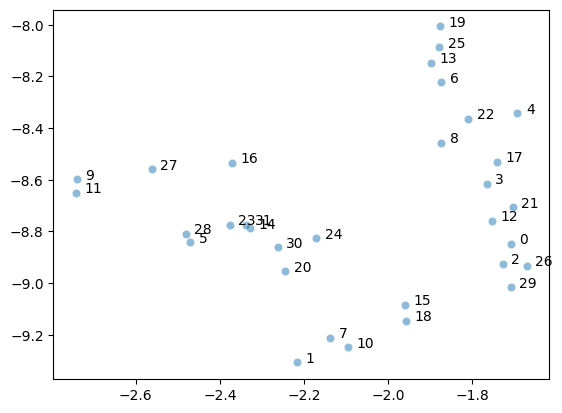

In [14]:
from sklearn.manifold import TSNE
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt

# Get sample batch
sample = next(iter(data_loader))

# Get representations
h = model(sample.to(device), train=False)
h = h.cpu().detach()
labels = []


# Get low-dimensional t-SNE Embeddings
h_embedded = TSNE(n_components=2,learning_rate='auto',
                   init='random').fit_transform(h.numpy())

# Plot
ax = sns.scatterplot(x=h_embedded[:,0], y=h_embedded[:,1],
                    alpha=0.5, palette="tab10")

# Add labels to be able to identify the data points
annotations = list(range(len(h_embedded[:,0])))

def label_points(x, y, val, ax):
    a = pd.concat({'x': x, 'y': y, 'val': val}, axis=1)
    for i, point in a.iterrows():
        ax.text(point['x']+.02, point['y'], str(int(point['val'])))

label_points(pd.Series(h_embedded[:,0]),
            pd.Series(h_embedded[:,1]),
            pd.Series(annotations),
            plt.gca())

In [11]:

plot_3d_shape_2(patches[0:32])
#sample_idx = 30
#plot_3d_shape_1(patches[sample_idx])

In [20]:
#plot_3d_shape_2([patches[19], patches[25], patches[13], patches[6]])
plot_3d_shape_2([patches[0], patches[2], patches[26], patches[29]])

Let's find the most similar and most different data points ...

[Source](https://stackoverflow.com/questions/50411191/how-to-compute-the-cosine-similarity-in-pytorch-for-all-rows-in-a-matrix-with-re)

In [ ]:
import numpy as np

def sim_matrix(a, b, eps=1e-8):
    """
    Eps for numerical stability
    """
    a_n, b_n = a.norm(dim=1)[:, None], b.norm(dim=1)[:, None]
    a_norm = a / torch.max(a_n, eps * torch.ones_like(a_n))
    b_norm = b / torch.max(b_n, eps * torch.ones_like(b_n))
    sim_mt = torch.mm(a_norm, b_norm.transpose(0, 1))
    return sim_mt

similarity = sim_matrix(h, h)
max_indices = torch.topk(similarity, k=2)[1][:, 1]
max_vals  = torch.topk(similarity, k=2)[0][:, 1]

# Select index
idx = 17
similar_idx = max_indices[idx]
print(f"Most similar data point in the embedding space for {idx} is {similar_idx}")

Most similar data point in the embedding space for 17 is 31


Categories are: "Table", "Lamp", "Guitar", "Motorbike", "Skateboard"

**Note**: This is only based on the data in the current batch!

In [ ]:
plot_3d_shape(sample[idx].cpu())

Number of data points:  2759


In [ ]:
plot_3d_shape(sample[similar_idx].cpu())

Number of data points:  2705


This confirms that our embedding space has a proper arrangement and that our contrastive loss separated different entities successfully.